In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
data = pd.read_csv('pivot_data_Liberia_DHSdata.csv')

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 76 entries, 0 to 75
Columns: 443 entries, Name to Population: Total_df11
dtypes: float64(441), int64(1), object(1)
memory usage: 263.2+ KB


In [ ]:
data.describe()

,Year,Children overweight,Children overweight for their age,Children severely stunted,Children severely underweight,Children severely wasted,Children stunted,Children underweight,Children wasted,Mean Body Mass Index (BMI) for women,...,Population using surface water_df11,Population using tanker truck_df11,Population using water piped into dwelling_df11,Population with don't know or missing information on water source_df11,Population with missing information on treatment of water_df11,Population with unknown or missing information on round trip time to water_df11,Population with water 30 minutes or less away round trip_df11,Population with water more than 30 minutes away round trip_df11,Population with water on the premises_df11,Population: Total_df11
count,76.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,48.000000,...,72.000000,72.000000,72.00000,45.000000,48.000000,66.000000,66.000000,66.000000,66.000000,72.0
mean,2013.236842,3.606250,0.958333,12.747917,3.956250,1.616667,32.933333,14.770833,5.322917,23.466667,...,16.480556,0.245833,0.36250,0.075556,0.100000,1.689394,79.345455,8.095455,10.869697,100.0
std,7.783518,1.880404,0.594597,4.687466,1.752798,1.272848,5.218190,4.427187,2.146371,0.965872,...,13.671268,0.723049,0.90716,0.131694,0.189063,1.545926,9.971562,4.295057,8.652700,0.0
min,1986.000000,1.100000,0.000000,4.800000,0.900000,0.000000,18.700000,7.200000,1.200000,21.700000,...,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,47.500000,1.300000,1.000000,100.0
25%,2011.000000,2.475000,0.575000,9.450000,2.600000,0.500000,30.550000,10.950000,3.775000,22.975000,...,6.675000,0.000000,0.00000,0.000000,0.000000,0.700000,75.750000,4.025000,6.325000,100.0
50%,2013.000000,3.300000,0.900000,12.050000,3.600000,1.700000,32.950000,14.650000,5.000000,23.400000,...,13.100000,0.000000,0.00000,0.000000,0.000000,1.350000,80.300000,8.150000,8.100000,100.0
75%,2019.000000,3.950000,1.300000,15.000000,5.325000,2.200000,35.100000,18.525000,6.850000,23.950000,...,25.000000,0.100000,0.10000,0.100000,0.100000,2.075000,87.225000,11.150000,11.525000,100.0
max,2022.000000,11.400000,3.000000,25.900000,8.400000,4.800000,45.200000,25.000000,9.800000,26.100000,...,75.200000,4.700000,5.90000,0.400000,0.900000,6.400000,94.000000,18.700000,38.100000,100.0


In [ ]:
print(data.columns.values)

['Name' 'Year' 'Children overweight' 'Children overweight for their age'
 'Children severely stunted' 'Children severely underweight'
 'Children severely wasted' 'Children stunted' 'Children underweight'
 'Children wasted' 'Mean Body Mass Index (BMI) for women'
 'Mean height for age of children' 'Mean weight for age of children'
 'Mean weight for height of children' 'Number of women'
 'Number of women (unweighted)'
 'Women who are mildly thin according to BMI (17.0-18.4)'
 'Women who are moderately thin according to BMI (<17.0)'
 'Women who are obese according to BMI (>=30.0)'
 'Women who are overweight according to BMI (25.0-29.9)'
 'Women who are overweight or obese according to BMI (>=25.0)'
 'Women who are thin according to BMI (<18.5)'
 'Women with height below 145 cm' 'Women with normal BMI (18.5-24.9)'
 'Antenatal care from a skilled provider'
 'Antenatal care provider: Auxiliary nurse/midwife'
 'Antenatal care provider: Doctor' 'Antenatal care provider: Missing '
 'Antenatal ca

In [ ]:
missing_values = data.isnull().sum()
print(missing_values)

Name                                                                                0
Year                                                                                0
Children overweight                                                                28
Children overweight for their age                                                  28
Children severely stunted                                                          28
                                                                                   ..
Population with unknown or missing information on round trip time to water_df11    10
Population with water 30 minutes or less away round trip_df11                      10
Population with water more than 30 minutes away round trip_df11                    10
Population with water on the premises_df11                                         10
Population: Total_df11                                                              4
Length: 443, dtype: int64


In [ ]:
threshold = 0.5
columns_to_drop = missing_values[missing_values > threshold * len(data)].index
data.drop(columns=columns_to_drop, inplace=True)

In [ ]:
missing_values = data.isnull().sum()

In [ ]:
missing_values

Name                                                                                0
Year                                                                                0
Children overweight                                                                28
Children overweight for their age                                                  28
Children severely stunted                                                          28
                                                                                   ..
Population with unknown or missing information on round trip time to water_df11    10
Population with water 30 minutes or less away round trip_df11                      10
Population with water more than 30 minutes away round trip_df11                    10
Population with water on the premises_df11                                         10
Population: Total_df11                                                              4
Length: 261, dtype: int64

In [ ]:
data.fillna(data.mean(), inplace=True)

<ipython-input-12-a20208f658ce>:1: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  data.fillna(data.mean(), inplace=True)


In [ ]:
data.dropna(inplace=True)

In [ ]:
data.sort_values(by=['Name', 'Year'], inplace=True)

In [ ]:
data

,Name,Year,Children overweight,Children overweight for their age,Children severely stunted,Children severely underweight,Children severely wasted,Children stunted,Children underweight,Children wasted,...,Population using surface water_df11,Population using tanker truck_df11,Population using water piped into dwelling_df11,Population with don't know or missing information on water source_df11,Population with missing information on treatment of water_df11,Population with unknown or missing information on round trip time to water_df11,Population with water 30 minutes or less away round trip_df11,Population with water more than 30 minutes away round trip_df11,Population with water on the premises_df11,Population: Total_df11
0,Bomi,2013,6.50000,0.000000,15.300000,4.00000,3.400000,33.100000,19.700000,8.800000,...,18.3,0.2,0.0,0.000000,0.0,0.7,87.3,9.9,2.1,100.0
1,Bomi,2019,1.80000,0.900000,9.100000,4.10000,2.700000,32.400000,14.200000,5.700000,...,3.4,0.0,0.0,0.075556,0.0,1.3,81.0,6.2,11.6,100.0
2,Bong,2013,2.80000,1.200000,14.600000,6.20000,2.900000,34.700000,17.400000,7.200000,...,17.2,0.0,0.0,0.400000,0.0,3.4,74.8,17.2,4.6,100.0
3,Bong,2019,7.50000,0.600000,11.400000,0.90000,1.100000,37.400000,9.300000,2.800000,...,8.0,0.2,0.0,0.075556,0.1,3.1,75.2,14.1,7.7,100.0
4,Gbarpolu,2013,1.70000,0.400000,6.900000,1.80000,4.800000,25.100000,10.800000,6.500000,...,28.3,0.0,0.0,0.000000,0.0,0.7,82.8,8.4,8.1,100.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53,South Eastern B,2011,3.60625,0.958333,12.747917,3.95625,1.616667,32.933333,14.770833,5.322917,...,32.6,0.0,0.0,0.000000,0.1,1.7,87.6,8.1,2.6,100.0
50,South Eastern B,2013,3.10000,1.100000,14.900000,4.00000,1.900000,34.100000,19.100000,4.200000,...,25.3,0.0,0.0,0.100000,0.1,5.2,78.3,7.8,8.7,100.0
69,South Eastern B,2016,3.60625,0.958333,12.747917,3.95625,1.616667,32.933333,14.770833,5.322917,...,9.0,0.0,0.0,0.000000,0.1,0.1,89.5,4.0,6.5,100.0
51,South Eastern B,2019,3.80000,1.200000,10.700000,2.30000,0.900000,34.000000,12.200000,4.700000,...,8.8,0.0,0.0,0.075556,0.4,0.5,77.1,14.2,8.1,100.0


In [ ]:
column_variances = data.var()

<ipython-input-17-39e70cc4e5b8>:1: FutureWarning: The default value of numeric_only in DataFrame.var is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.
  column_variances = data.var()


In [ ]:
sorted_columns = column_variances.sort_values(ascending=False)

In [ ]:
sorted_columns

Number of persons_y_df11                                                                                 2.085811e+07
Number of persons_x_df11                                                                                 1.864111e+07
Number of persons living in a household with at least one insecticide-treated mosquito net (ITN)_df11    4.993631e+06
Number of persons (unweighted)_y_df11                                                                    4.941552e+06
Number of persons (unweighted)_x_df11                                                                    4.367347e+06
                                                                                                             ...     
Antenatal care: Total                                                                                    0.000000e+00
Households: Total_df11                                                                                   0.000000e+00
Women's literacy: Total_df11                            

In [ ]:
#Selecting top 70 columns
selected_columns = sorted_columns[:70].index

In [ ]:
data_selected = data[selected_columns]

In [ ]:
data_selected

,Number of persons_y_df11,Number of persons_x_df11,Number of persons living in a household with at least one insecticide-treated mosquito net (ITN)_df11,Number of persons (unweighted)_y_df11,Number of persons (unweighted)_x_df11,Number of persons living in a household with at least one insecticide-treated mosquito net (ITN) (unweighted)_df11,Number of women_y_df11,Number of households_y_df11,Number of households_x_df11,Number of households with a least one person who stayed in the household last night_df11,...,Women with secondary or higher education_y_df3,Women with secondary or higher education_y_df11,Men who can read a whole sentence_df11,"SP/Fansidar 2+ doses, at least one during ANC visit_df11",Population using an improved water source_df11,Households using an improved water source_df11,Children who took any ACT_df3,Received all 8 basic vaccinations_y_df3,Households with electricity_y_df3,Women with secondary or higher education_x_df11
0,1335.0,1311.0,936.0,2301.0,2249.0,1632.0,244.000000,280.0,280.0,279.0,...,28.7,28.7,2.800000,52.4,80.3,81.9,74.80000,72.700000,0.4,28.700000
1,1344.0,1311.0,792.0,1984.0,1932.0,1221.0,249.000000,319.0,319.0,316.0,...,30.8,30.8,46.700000,80.3,92.1,90.8,56.55641,56.800000,10.0,2.300000
2,4974.0,4839.0,3371.0,3262.0,3181.0,2265.0,894.000000,1118.0,1118.0,1116.0,...,13.2,13.2,4.800000,52.1,56.1,55.1,46.10000,50.400000,0.3,13.200000
3,4061.0,3964.0,2649.0,3235.0,3143.0,2040.0,796.000000,868.0,868.0,863.0,...,29.7,29.7,41.600000,68.8,78.1,76.2,56.55641,53.200000,3.0,4.700000
4,992.0,963.0,633.0,2481.0,2401.0,1639.0,182.000000,212.0,212.0,212.0,...,13.2,13.2,4.700000,33.5,60.3,61.1,14.50000,52.200000,2.4,13.200000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53,1229.0,1193.0,779.0,3655.0,3552.0,2244.0,926.181818,246.0,246.0,245.0,...,23.0,23.0,22.179167,61.8,61.9,62.0,67.90000,44.551724,1.2,13.404545
50,3291.0,3144.0,1495.0,8196.0,7815.0,4103.0,577.000000,571.0,571.0,568.0,...,24.6,24.6,3.500000,41.2,65.4,65.5,56.50000,39.700000,1.7,24.600000
69,1336.0,1258.0,907.0,4073.0,3817.0,2827.0,233.000000,231.0,231.0,228.0,...,30.7,30.7,22.179167,68.4,90.3,90.3,90.80000,39.000000,7.2,0.700000
51,2420.0,2335.0,1449.0,7778.0,7480.0,4661.0,441.000000,473.0,473.0,469.0,...,30.2,30.2,46.100000,71.8,83.1,81.4,56.55641,47.100000,14.0,2.000000


In [ ]:
data_selected['Name'] = data['Name']
data_selected['Year'] = data['Year']

<ipython-input-23-a2b72934295a>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_selected['Name'] = data['Name']
<ipython-input-23-a2b72934295a>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_selected['Year'] = data['Year']


In [ ]:
data_selected

,Number of persons_y_df11,Number of persons_x_df11,Number of persons living in a household with at least one insecticide-treated mosquito net (ITN)_df11,Number of persons (unweighted)_y_df11,Number of persons (unweighted)_x_df11,Number of persons living in a household with at least one insecticide-treated mosquito net (ITN) (unweighted)_df11,Number of women_y_df11,Number of households_y_df11,Number of households_x_df11,Number of households with a least one person who stayed in the household last night_df11,...,Men who can read a whole sentence_df11,"SP/Fansidar 2+ doses, at least one during ANC visit_df11",Population using an improved water source_df11,Households using an improved water source_df11,Children who took any ACT_df3,Received all 8 basic vaccinations_y_df3,Households with electricity_y_df3,Women with secondary or higher education_x_df11,Name,Year
0,1335.0,1311.0,936.0,2301.0,2249.0,1632.0,244.000000,280.0,280.0,279.0,...,2.800000,52.4,80.3,81.9,74.80000,72.700000,0.4,28.700000,Bomi,2013
1,1344.0,1311.0,792.0,1984.0,1932.0,1221.0,249.000000,319.0,319.0,316.0,...,46.700000,80.3,92.1,90.8,56.55641,56.800000,10.0,2.300000,Bomi,2019
2,4974.0,4839.0,3371.0,3262.0,3181.0,2265.0,894.000000,1118.0,1118.0,1116.0,...,4.800000,52.1,56.1,55.1,46.10000,50.400000,0.3,13.200000,Bong,2013
3,4061.0,3964.0,2649.0,3235.0,3143.0,2040.0,796.000000,868.0,868.0,863.0,...,41.600000,68.8,78.1,76.2,56.55641,53.200000,3.0,4.700000,Bong,2019
4,992.0,963.0,633.0,2481.0,2401.0,1639.0,182.000000,212.0,212.0,212.0,...,4.700000,33.5,60.3,61.1,14.50000,52.200000,2.4,13.200000,Gbarpolu,2013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53,1229.0,1193.0,779.0,3655.0,3552.0,2244.0,926.181818,246.0,246.0,245.0,...,22.179167,61.8,61.9,62.0,67.90000,44.551724,1.2,13.404545,South Eastern B,2011
50,3291.0,3144.0,1495.0,8196.0,7815.0,4103.0,577.000000,571.0,571.0,568.0,...,3.500000,41.2,65.4,65.5,56.50000,39.700000,1.7,24.600000,South Eastern B,2013
69,1336.0,1258.0,907.0,4073.0,3817.0,2827.0,233.000000,231.0,231.0,228.0,...,22.179167,68.4,90.3,90.3,90.80000,39.000000,7.2,0.700000,South Eastern B,2016
51,2420.0,2335.0,1449.0,7778.0,7480.0,4661.0,441.000000,473.0,473.0,469.0,...,46.100000,71.8,83.1,81.4,56.55641,47.100000,14.0,2.000000,South Eastern B,2019


In [ ]:
summary_statistics = data_selected.describe()
summary_statistics

,Number of persons_y_df11,Number of persons_x_df11,Number of persons living in a household with at least one insecticide-treated mosquito net (ITN)_df11,Number of persons (unweighted)_y_df11,Number of persons (unweighted)_x_df11,Number of persons living in a household with at least one insecticide-treated mosquito net (ITN) (unweighted)_df11,Number of women_y_df11,Number of households_y_df11,Number of households_x_df11,Number of households with a least one person who stayed in the household last night_df11,...,Women with secondary or higher education_y_df11,Men who can read a whole sentence_df11,"SP/Fansidar 2+ doses, at least one during ANC visit_df11",Population using an improved water source_df11,Households using an improved water source_df11,Children who took any ACT_df3,Received all 8 basic vaccinations_y_df3,Households with electricity_y_df3,Women with secondary or higher education_x_df11,Year
count,76.000000,76.000000,76.000000,76.000000,76.000000,76.000000,76.000000,76.000000,76.000000,76.000000,...,76.000000,76.000000,76.000000,76.000000,76.000000,76.000000,76.000000,76.000000,76.000000,76.000000
mean,4470.930556,4235.681818,2403.393939,4236.152778,3971.803030,2440.151515,926.181818,922.805556,903.318182,898.833333,...,28.902778,22.179167,57.856061,74.063889,73.351389,56.556410,44.551724,9.338889,13.404545,2013.236842
std,4567.068417,4317.535199,2234.643285,2222.960139,2089.819911,1334.699020,1001.160073,974.183236,950.297163,946.804134,...,15.216666,15.043315,15.017245,14.994090,14.988057,14.786776,14.291277,13.950250,13.732457,7.783518
min,504.000000,480.000000,332.000000,1881.000000,1784.000000,963.000000,91.000000,97.000000,97.000000,96.000000,...,9.000000,0.600000,22.000000,24.400000,25.600000,14.500000,0.700000,0.000000,0.100000,1986.000000
25%,1416.500000,1359.500000,928.000000,2912.500000,2799.250000,1591.000000,259.250000,288.250000,288.250000,287.250000,...,18.675000,7.475000,47.050000,65.275000,62.875000,56.500000,38.975000,1.600000,2.000000,2011.000000
50%,2656.500000,3265.000000,1579.000000,3529.500000,3415.500000,2197.000000,599.000000,580.500000,661.000000,658.000000,...,26.200000,22.179167,57.856061,74.063889,73.351389,56.556410,44.551724,4.300000,12.350000,2013.000000
75%,5449.750000,4500.750000,2898.000000,4506.750000,3971.803030,2679.250000,940.886364,1088.000000,936.250000,931.750000,...,32.450000,29.875000,67.950000,85.150000,83.550000,57.092308,53.050000,10.050000,16.825000,2019.000000
max,21857.000000,21487.000000,10510.000000,12211.000000,11969.000000,7491.000000,4854.000000,4645.000000,4645.000000,4630.000000,...,70.700000,55.400000,91.400000,99.100000,99.300000,92.800000,73.600000,73.500000,60.200000,2022.000000


In [ ]:
correlation_matrix = data_selected.corr()
correlation_matrix

<ipython-input-28-25d0ffbaa93f>:1: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = data_selected.corr()


,Number of persons_y_df11,Number of persons_x_df11,Number of persons living in a household with at least one insecticide-treated mosquito net (ITN)_df11,Number of persons (unweighted)_y_df11,Number of persons (unweighted)_x_df11,Number of persons living in a household with at least one insecticide-treated mosquito net (ITN) (unweighted)_df11,Number of women_y_df11,Number of households_y_df11,Number of households_x_df11,Number of households with a least one person who stayed in the household last night_df11,...,Women with secondary or higher education_y_df11,Men who can read a whole sentence_df11,"SP/Fansidar 2+ doses, at least one during ANC visit_df11",Population using an improved water source_df11,Households using an improved water source_df11,Children who took any ACT_df3,Received all 8 basic vaccinations_y_df3,Households with electricity_y_df3,Women with secondary or higher education_x_df11,Year
Number of persons_y_df11,1.000000,0.966844,0.922752,0.707231,0.695088,0.573755,0.979686,0.992507,0.960148,0.960024,...,0.582870,0.021738,-0.026223,0.389709,0.398780,-0.282670,0.208477,0.452593,0.457992,-0.024818
Number of persons_x_df11,0.966844,1.000000,0.952106,0.686312,0.716530,0.589783,0.948079,0.969118,0.993478,0.993384,...,0.591535,0.044818,-0.030113,0.395766,0.401521,-0.295546,0.193354,0.476711,0.436644,-0.002108
Number of persons living in a household with at least one insecticide-treated mosquito net (ITN)_df11,0.922752,0.952106,1.000000,0.718424,0.747579,0.709025,0.869982,0.904289,0.927018,0.926219,...,0.485950,0.021603,0.060656,0.366960,0.369029,-0.244509,0.200888,0.373296,0.306567,0.031695
Number of persons (unweighted)_y_df11,0.707231,0.686312,0.718424,1.000000,0.968023,0.908393,0.658341,0.684527,0.667358,0.666765,...,0.188921,-0.090660,-0.040899,0.110024,0.115920,-0.178371,0.059469,0.106729,0.291635,-0.071449
Number of persons (unweighted)_x_df11,0.695088,0.716530,0.747579,0.968023,1.000000,0.936642,0.644611,0.680243,0.697341,0.696768,...,0.214107,-0.042866,-0.045927,0.135363,0.141233,-0.190544,0.107730,0.140901,0.255166,-0.015169
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Children who took any ACT_df3,-0.282670,-0.295546,-0.244509,-0.178371,-0.190544,-0.112838,-0.265170,-0.274100,-0.280989,-0.281428,...,-0.130446,0.199754,0.305592,0.023934,0.016612,1.000000,-0.047249,-0.048632,-0.480854,0.060857
Received all 8 basic vaccinations_y_df3,0.208477,0.193354,0.200888,0.059469,0.107730,0.144603,0.213633,0.214803,0.194446,0.194341,...,0.190492,-0.029038,0.031379,0.316137,0.315904,-0.047249,1.000000,0.146830,0.162876,0.603651
Households with electricity_y_df3,0.452593,0.476711,0.373296,0.106729,0.140901,0.037568,0.509554,0.500017,0.517263,0.518106,...,0.819004,0.377018,0.264649,0.538256,0.558669,-0.048632,0.146830,1.000000,0.036878,0.250514
Women with secondary or higher education_x_df11,0.457992,0.436644,0.306567,0.291635,0.255166,0.087410,0.511856,0.441616,0.415305,0.416464,...,0.321302,-0.570896,-0.527819,0.166558,0.184018,-0.480854,0.162876,0.036878,1.000000,-0.294645


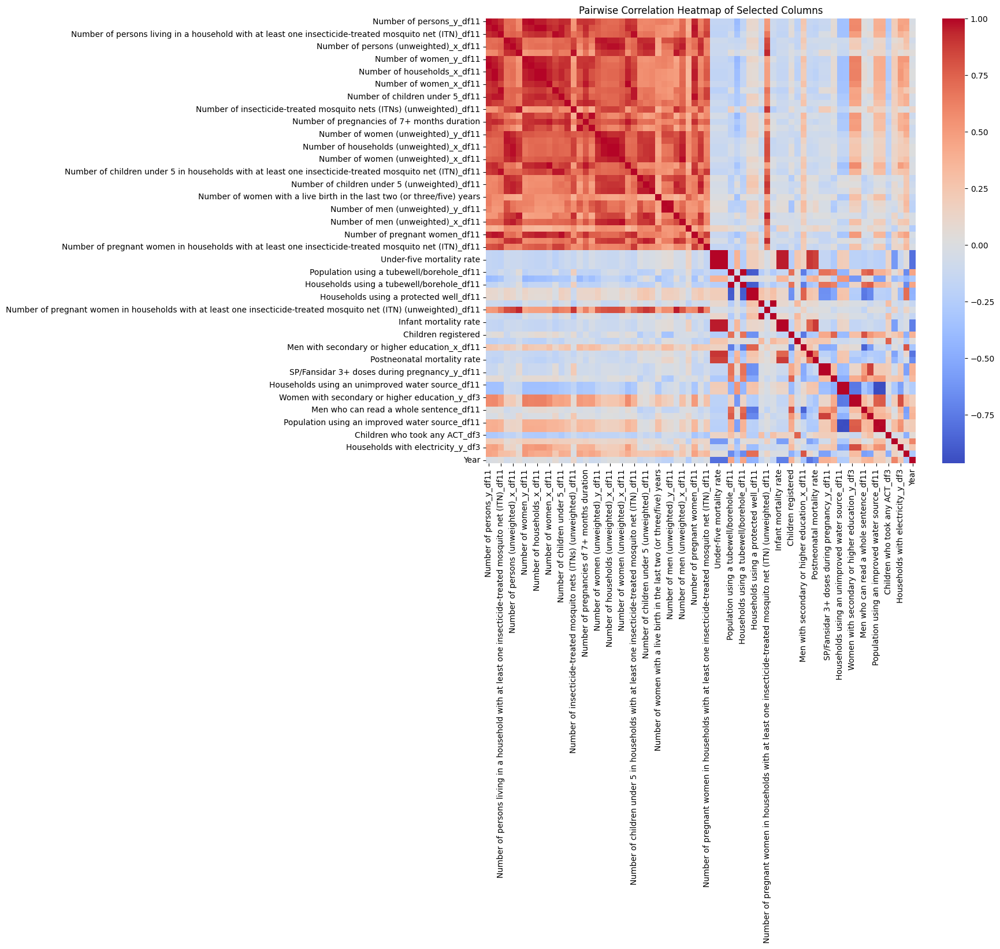

In [ ]:
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, cmap='coolwarm', annot=False, fmt=".2f")
plt.title('Pairwise Correlation Heatmap of Selected Columns')
plt.show()

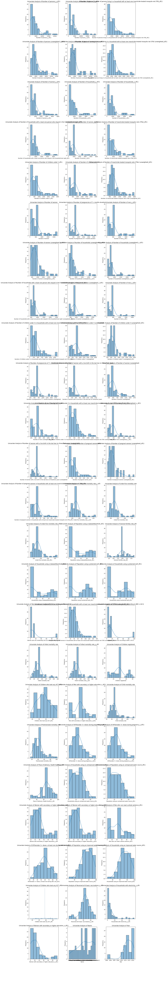

In [ ]:
num_cols = len(data_selected.columns)
fig, axes = plt.subplots(nrows=num_cols // 3 + 1, ncols=3, figsize=(15, 5 * (num_cols // 3 + 1)))
fig.tight_layout(pad=5.0)

for i, column in enumerate(data_selected.columns):
    ax = axes[i // 3, i % 3]

    # Plot histogram
    sns.histplot(data_selected[column], ax=ax, kde=True)
    ax.set_title(f'Univariate Analysis of {column}')
    ax.set_xlabel(column)
    ax.set_ylabel('Frequency')

for i in range(len(data_selected.columns), len(axes.flatten())):
    axes.flatten()[i].axis('off')

plt.show()

In [ ]:
print(data_selected.columns.values)

['Number of persons_y_df11' 'Number of persons_x_df11'
 'Number of persons living in a household with at least one insecticide-treated mosquito net (ITN)_df11'
 'Number of persons (unweighted)_y_df11'
 'Number of persons (unweighted)_x_df11'
 'Number of persons living in a household with at least one insecticide-treated mosquito net (ITN) (unweighted)_df11'
 'Number of women_y_df11' 'Number of households_y_df11'
 'Number of households_x_df11'
 'Number of households with a least one person who stayed in the household last night_df11'
 'Number of women_x_df11'
 'Number of insecticide-treated mosquito nets (ITNs)_df11'
 'Number of children under 5_df11' 'Number of children under 5'
 'Number of insecticide-treated mosquito nets (ITNs) (unweighted)_df11'
 'Number of women' 'Number of pregnancies of 7+ months duration'
 'Number of men_y_df11' 'Number of women (unweighted)_y_df11'
 'Number of households (unweighted)_y_df11'
 'Number of households (unweighted)_x_df11'
 'Number of households wi

In [ ]:
def plot_name_vs_column(data, column):
    plt.figure(figsize=(15, 6))
    sns.barplot(x='Name', y=column, data=data)
    plt.title(f'{column} vs Country Name')
    plt.xticks(rotation=90)
    plt.xlabel('Country Name')
    plt.ylabel(column)
    plt.show()

def plot_year_vs_column(data, column):
    plt.figure(figsize=(10, 6))
    sns.lineplot(x='Year', y=column, data=data)
    plt.title(f'{column} over Years')
    plt.xlabel('Year')
    plt.ylabel(column)
    plt.show()

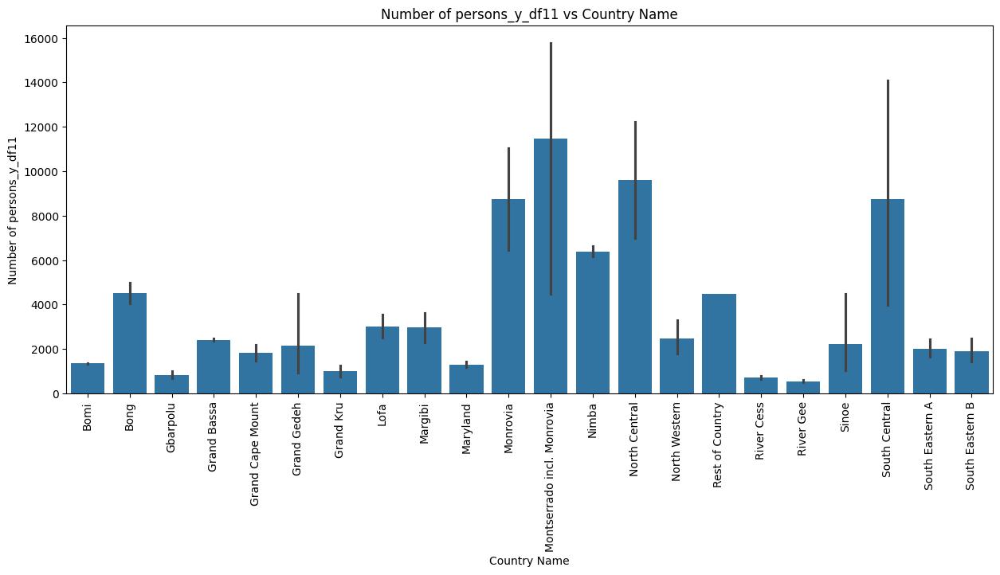

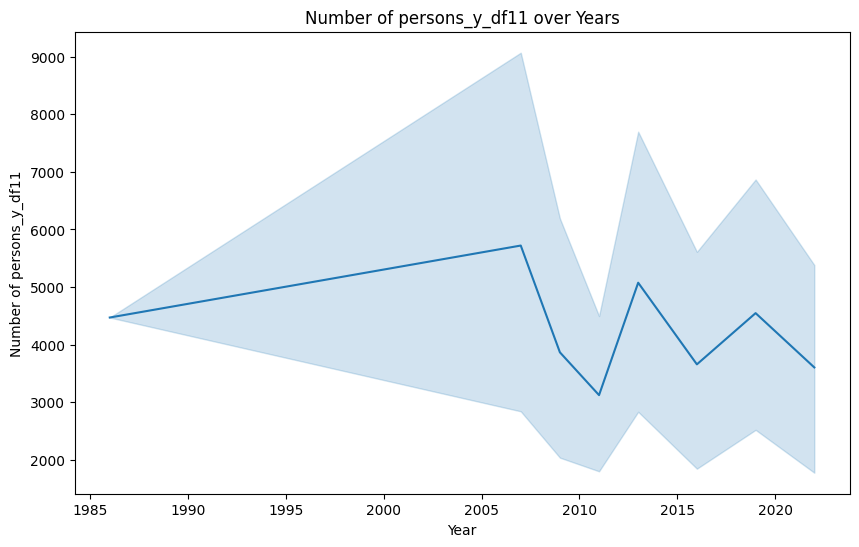

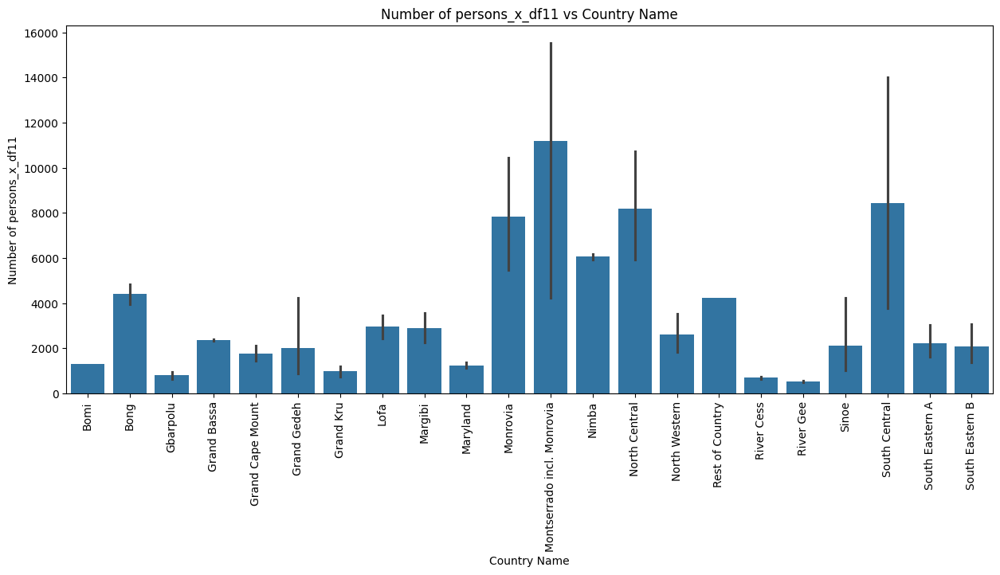

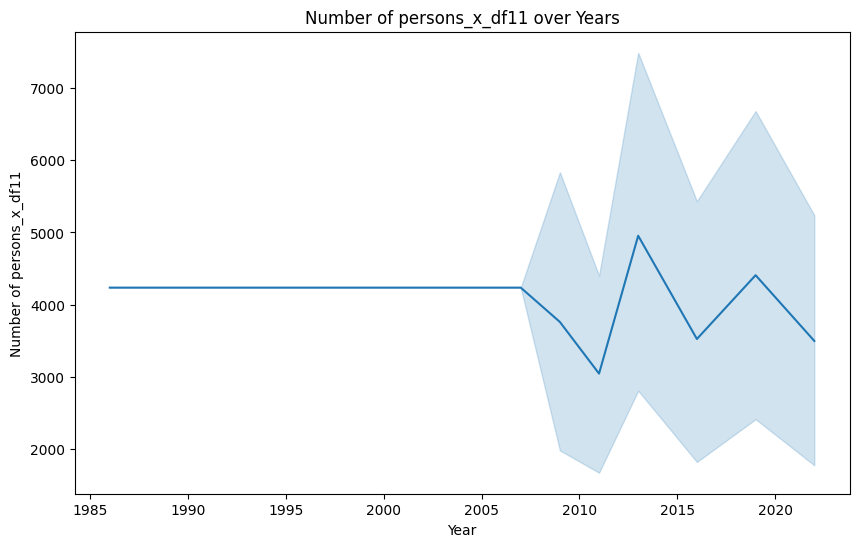

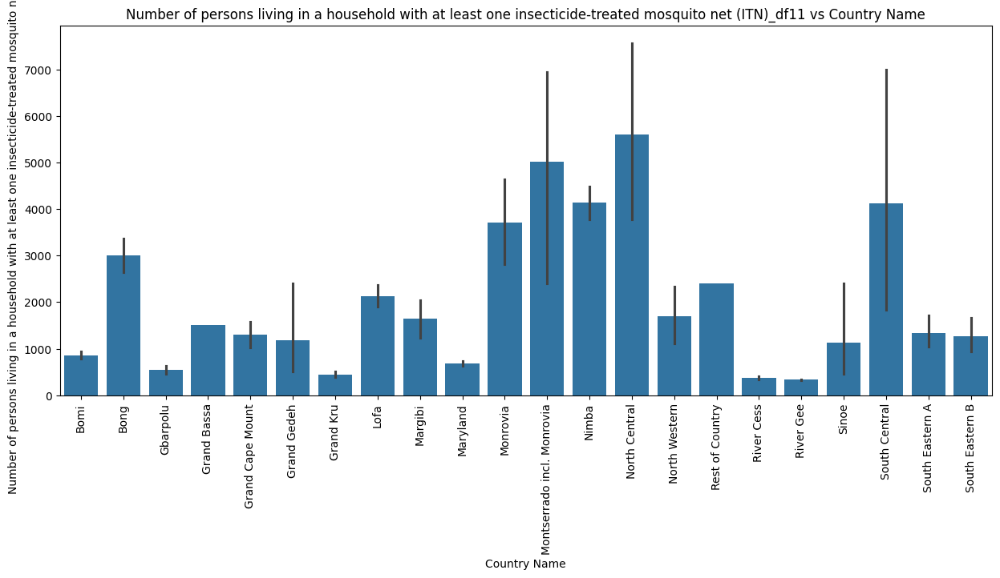

...

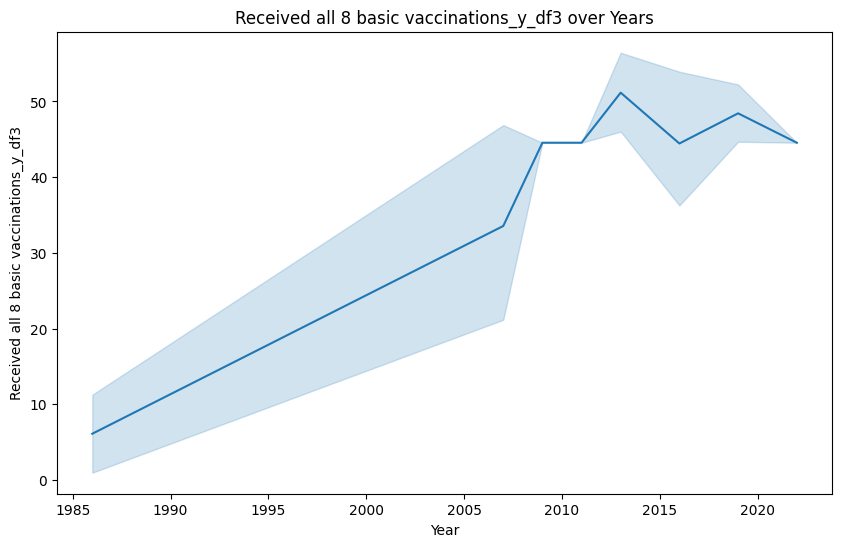

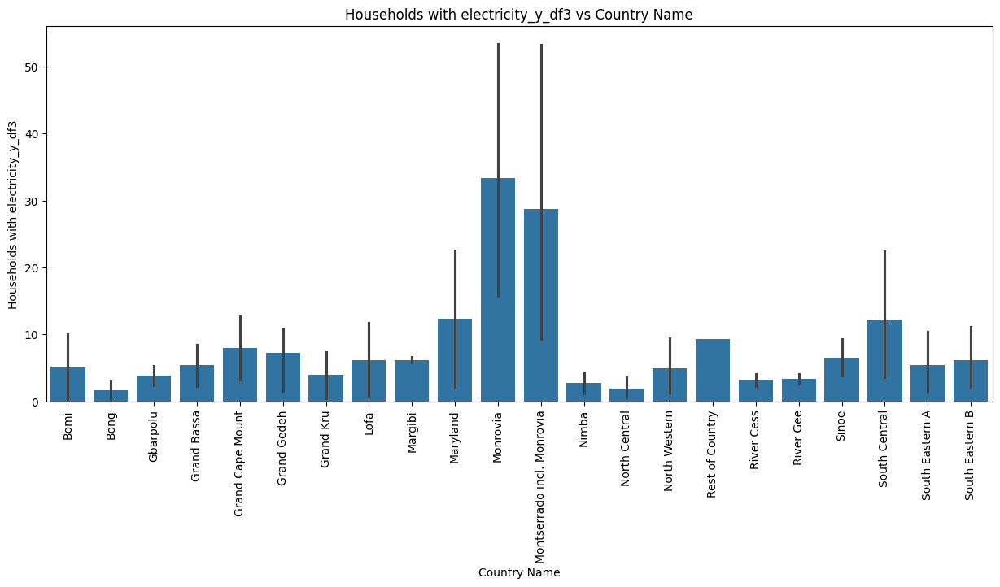

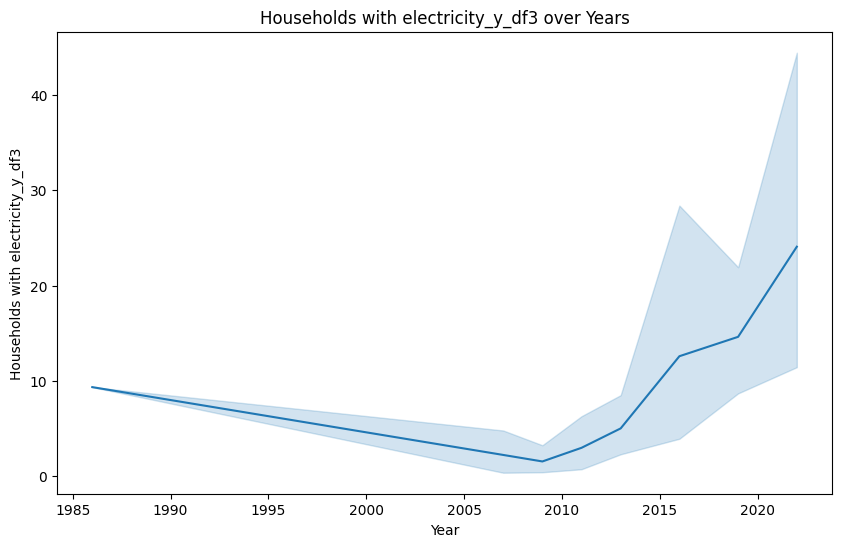

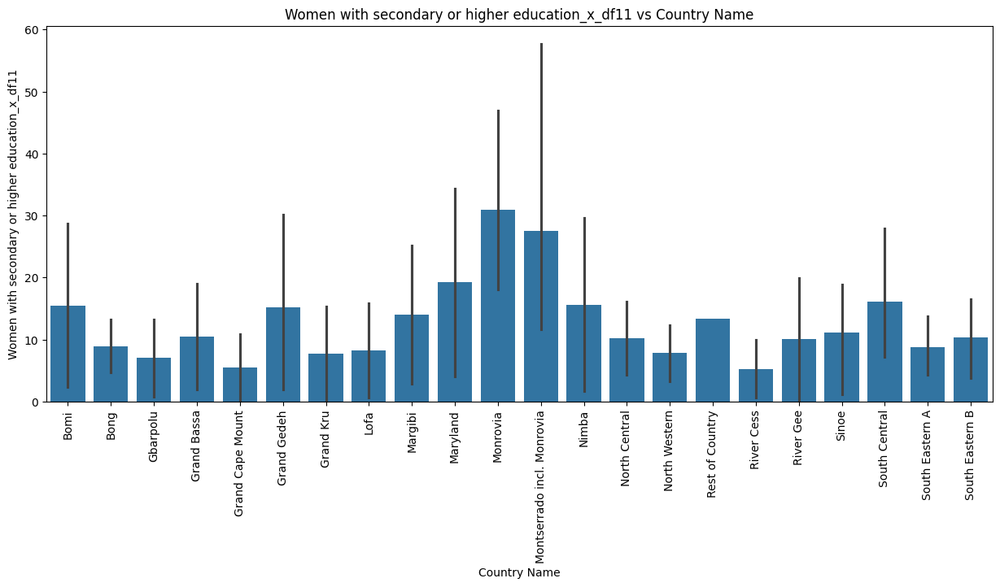

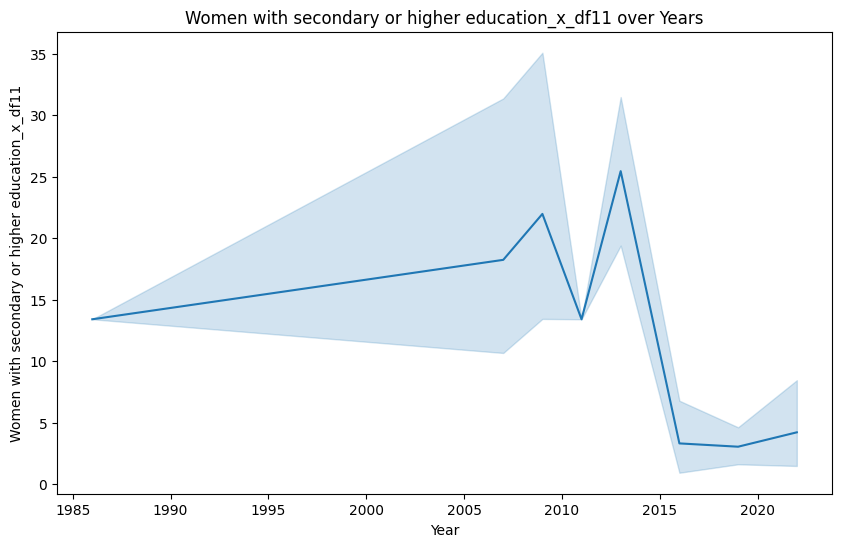

In [ ]:
for column in data_selected.columns:
    if column != 'Name' and column != 'Year':
        plot_name_vs_column(data_selected, column)
        plot_year_vs_column(data_selected, column)

In [ ]:
countries = data_selected['Name'].unique()

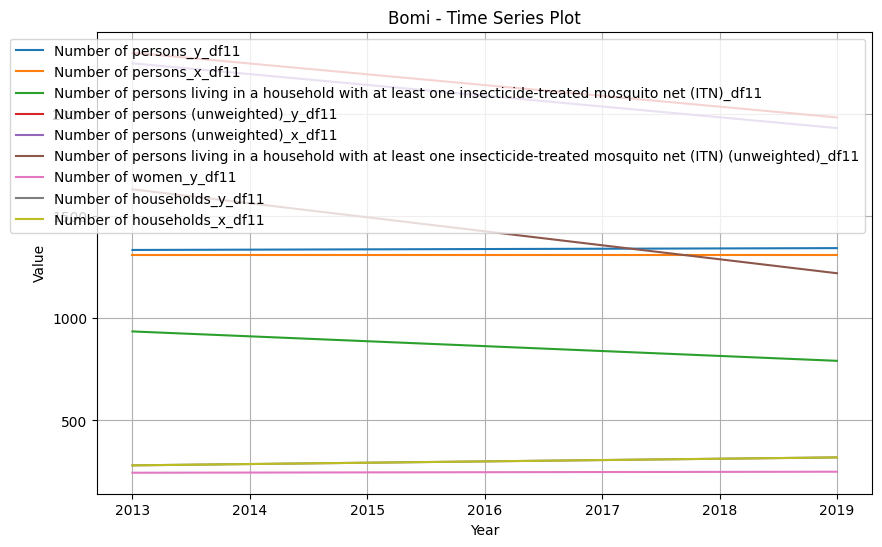

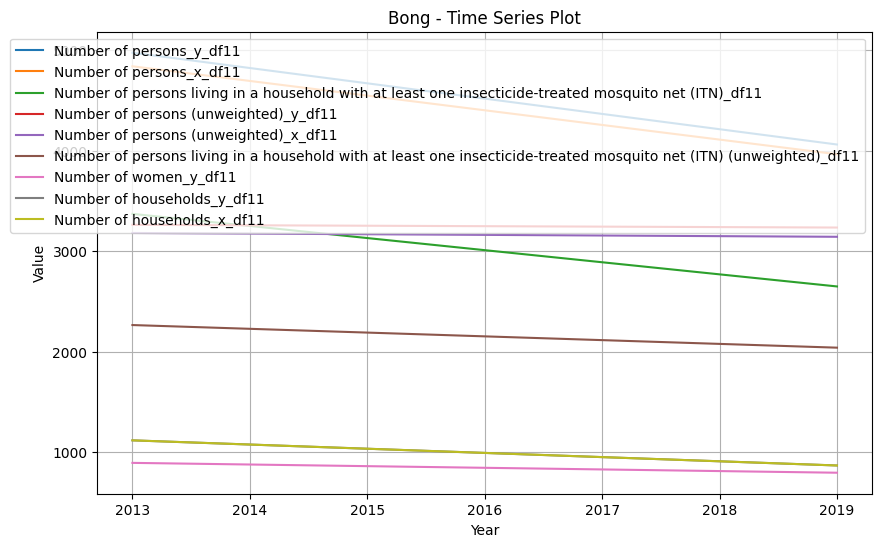

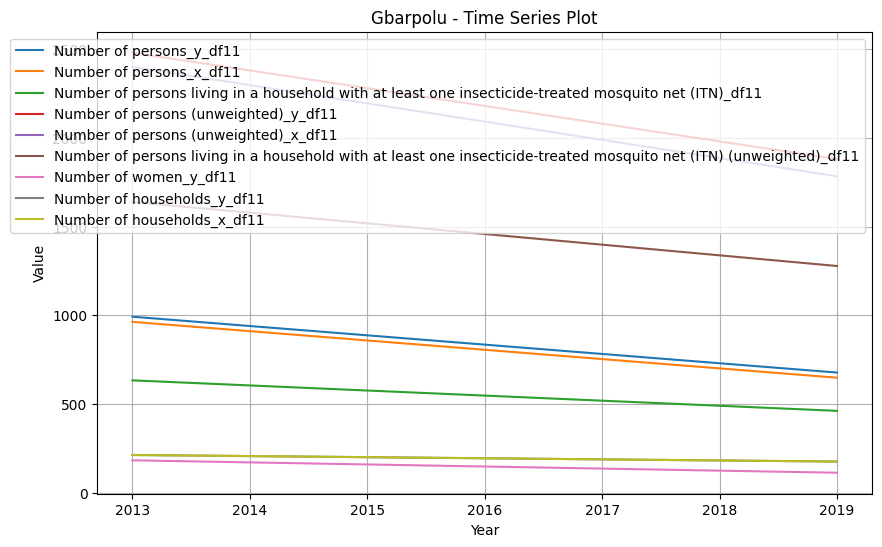

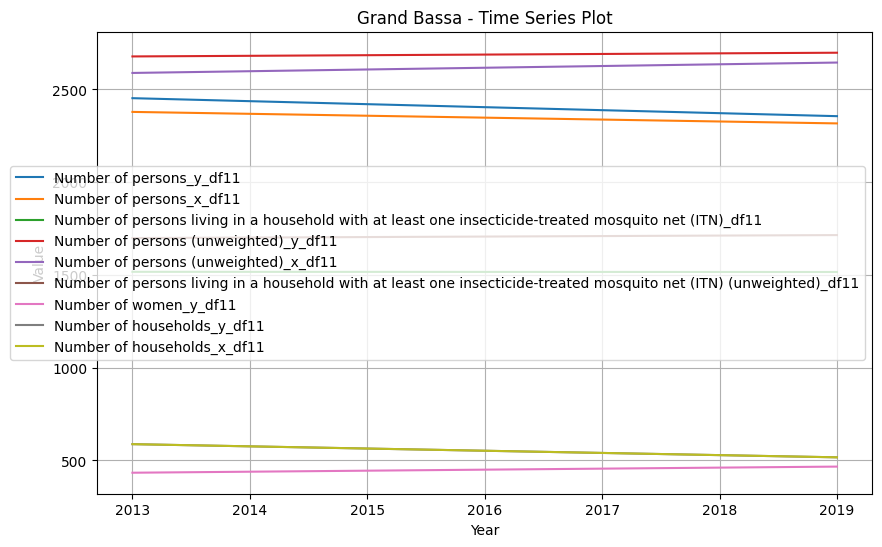

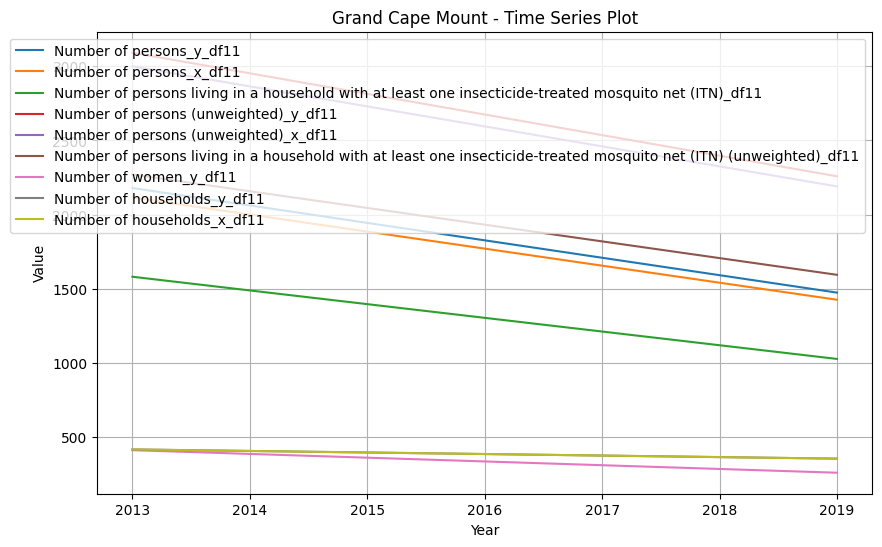

...

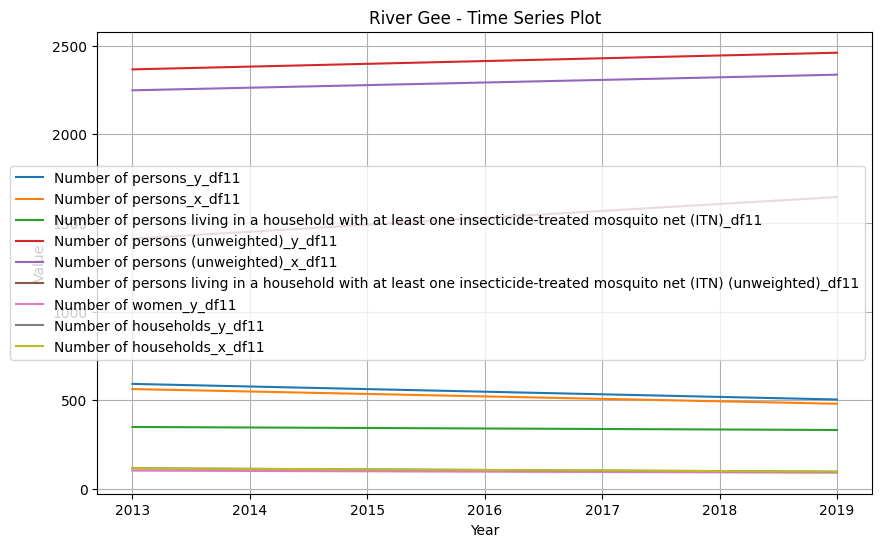

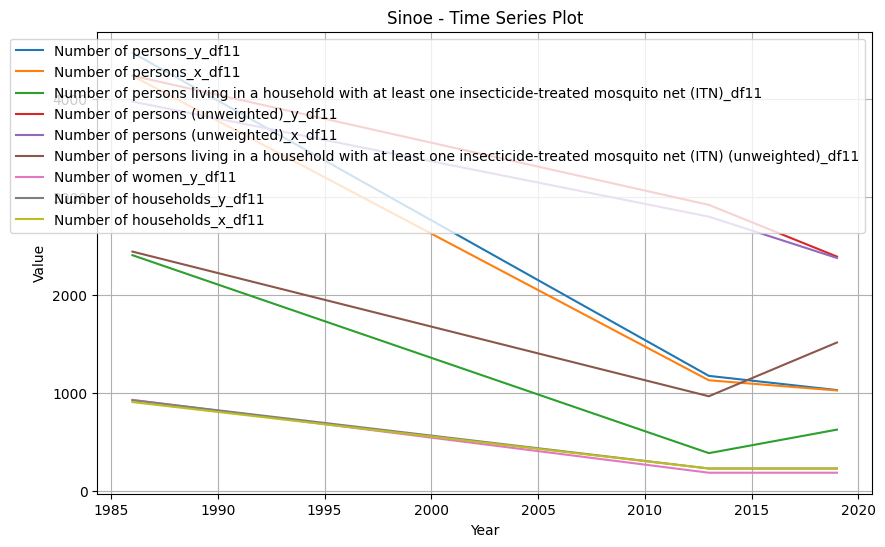

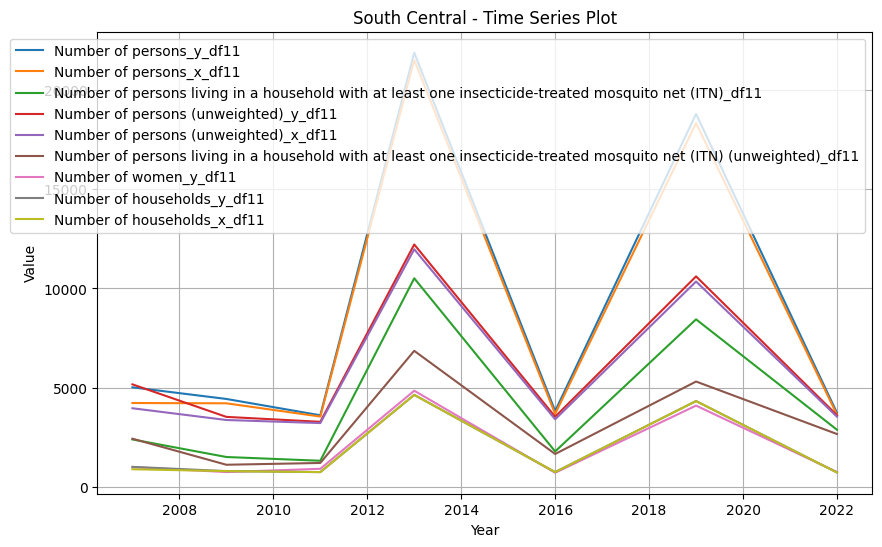

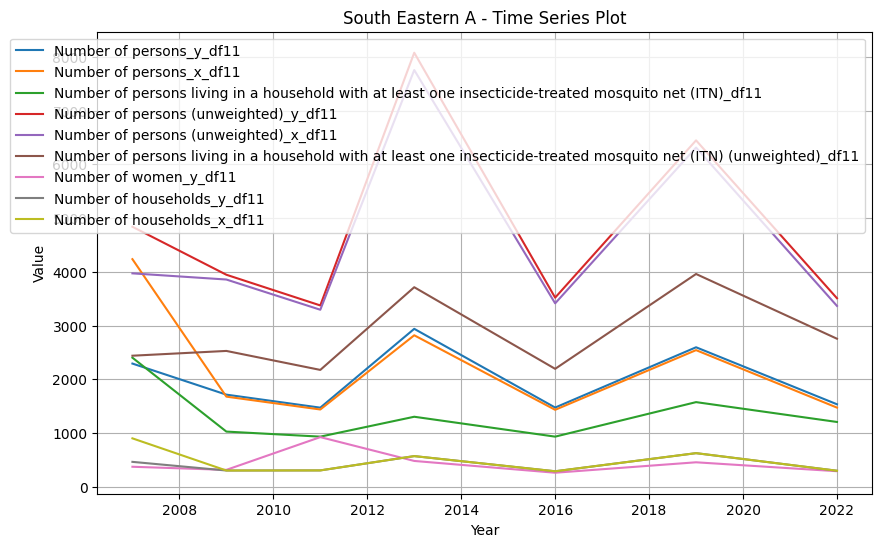

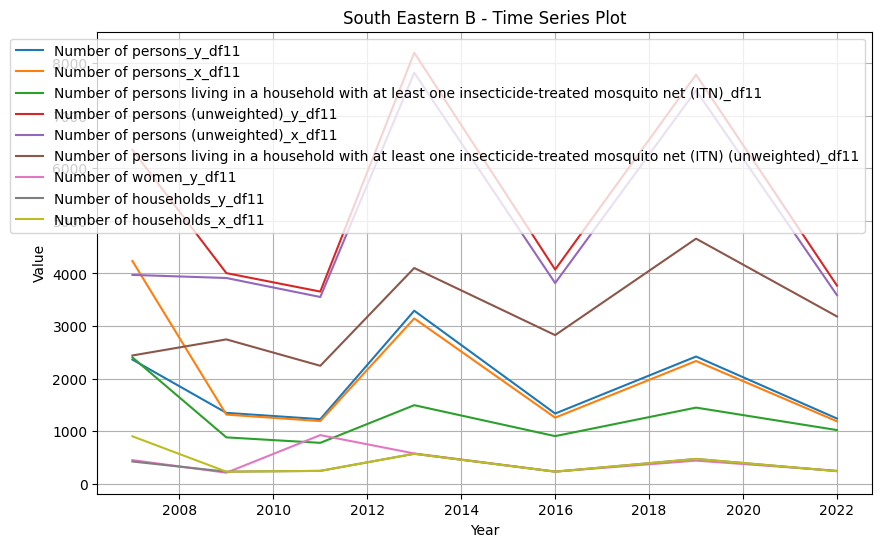

In [ ]:
for country in countries:
    country_data = data_selected[data_selected['Name'] == country]
    years = country_data['Year']
    columns_to_plot = ['Number of persons_y_df11', 'Number of persons_x_df11',
 'Number of persons living in a household with at least one insecticide-treated mosquito net (ITN)_df11',
 'Number of persons (unweighted)_y_df11',
 'Number of persons (unweighted)_x_df11',
 'Number of persons living in a household with at least one insecticide-treated mosquito net (ITN) (unweighted)_df11',
 'Number of women_y_df11', 'Number of households_y_df11',
 'Number of households_x_df11']

    plt.figure(figsize=(10, 6))
    for column in columns_to_plot:
        plt.plot(years, country_data[column], label=column)

    plt.title(f'{country} - Time Series Plot')
    plt.xlabel('Year')
    plt.ylabel('Value')
    plt.legend()
    plt.grid(True)
    plt.show()

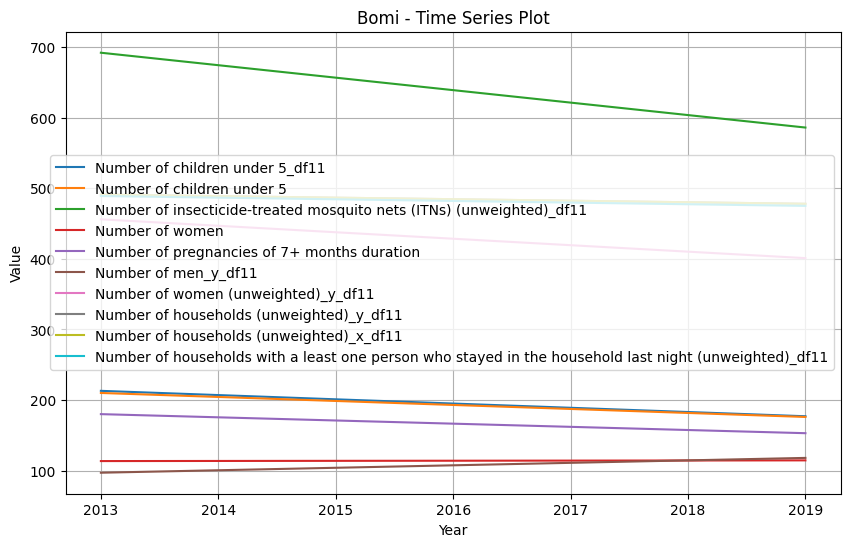

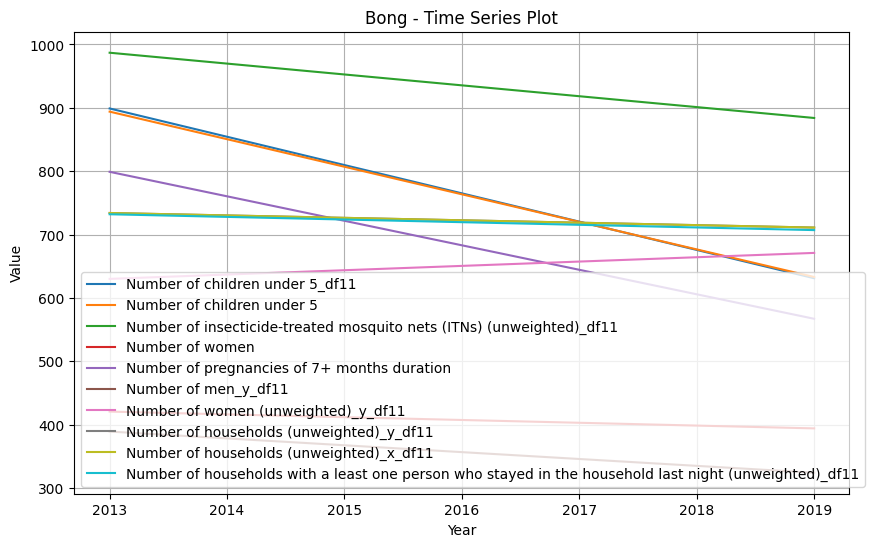

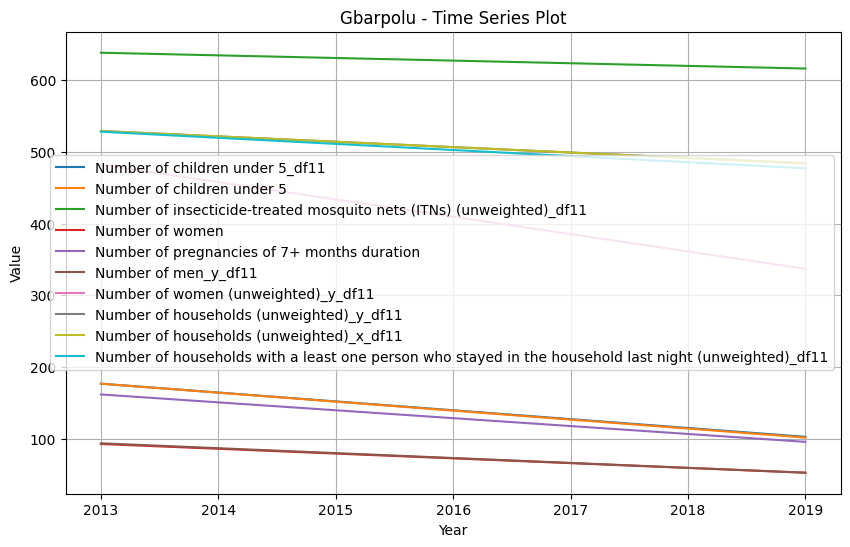

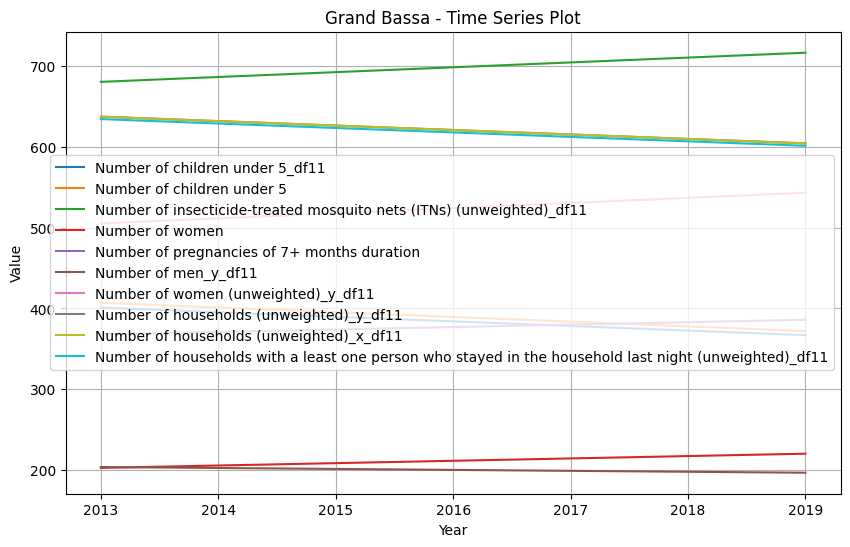

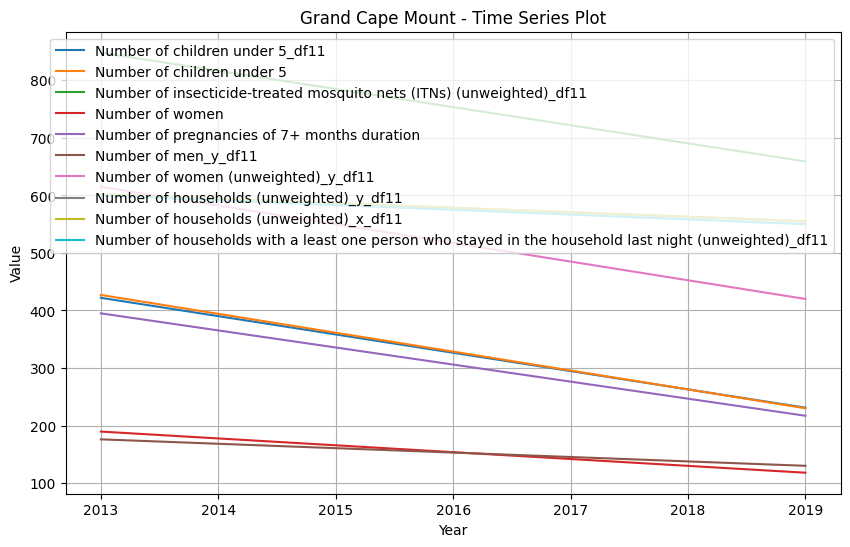

...

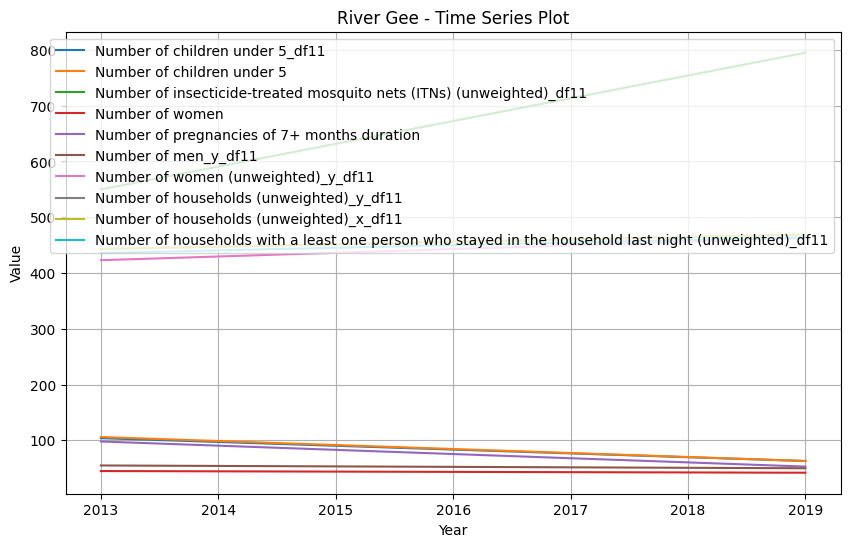

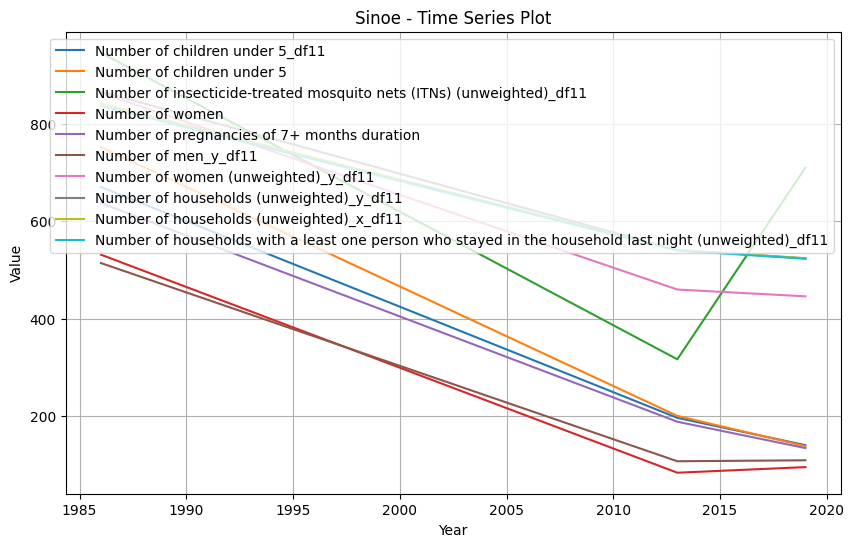

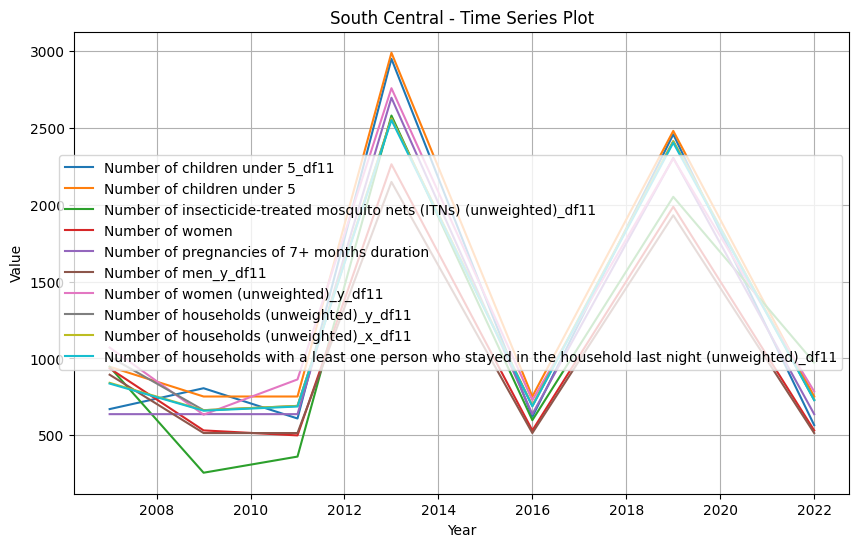

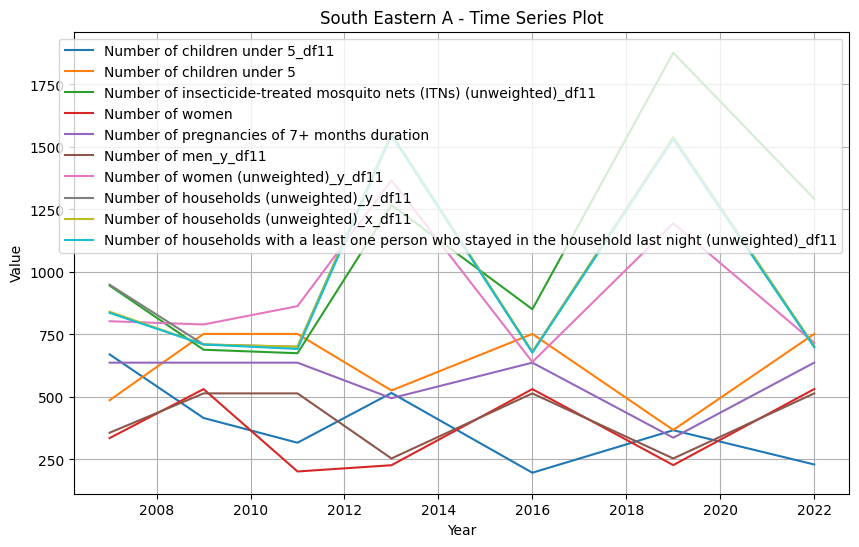

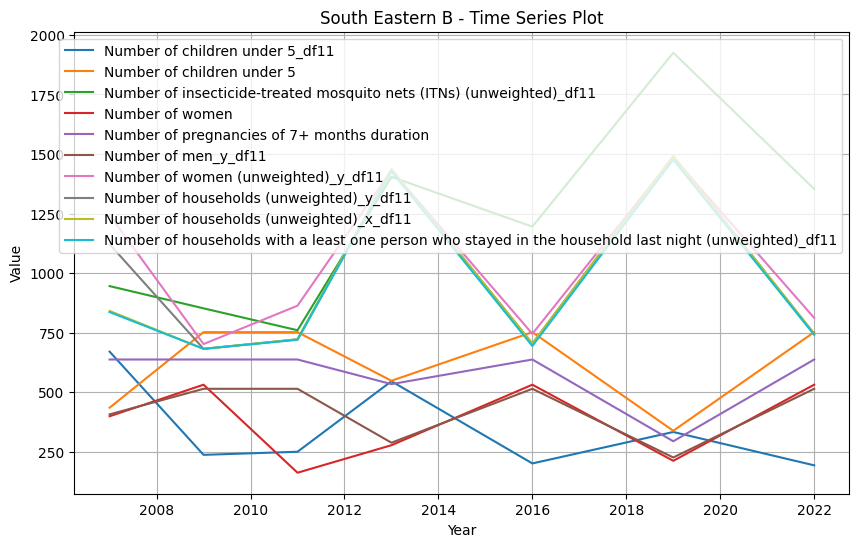

In [ ]:
for country in countries:
    country_data = data_selected[data_selected['Name'] == country]
    years = country_data['Year']
    columns_to_plot = [
 'Number of children under 5_df11', 'Number of children under 5',
 'Number of insecticide-treated mosquito nets (ITNs) (unweighted)_df11',
 'Number of women', 'Number of pregnancies of 7+ months duration',
 'Number of men_y_df11', 'Number of women (unweighted)_y_df11',
 'Number of households (unweighted)_y_df11',
 'Number of households (unweighted)_x_df11',
 'Number of households with a least one person who stayed in the household last night (unweighted)_df11',
 ]

    plt.figure(figsize=(10, 6))
    for column in columns_to_plot:
        plt.plot(years, country_data[column], label=column)

    plt.title(f'{country} - Time Series Plot')
    plt.xlabel('Year')
    plt.ylabel('Value')
    plt.legend()
    plt.grid(True)
    plt.show()

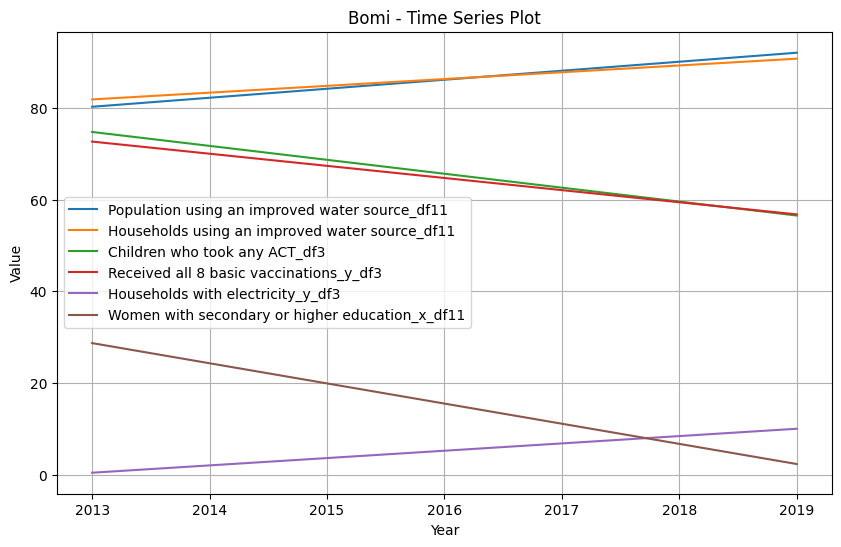

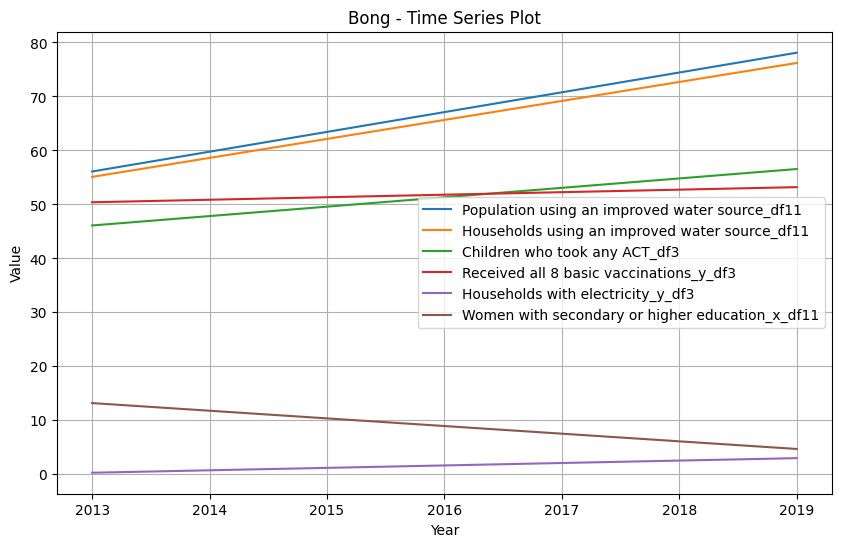

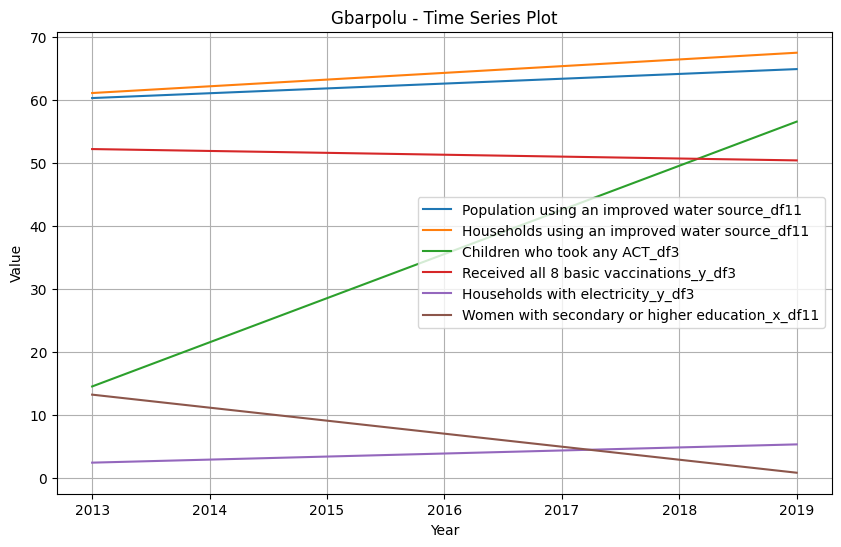

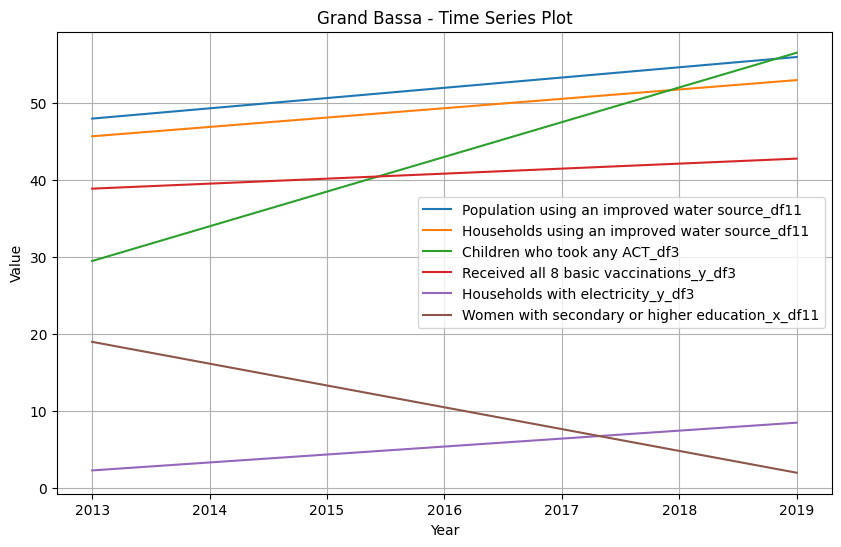

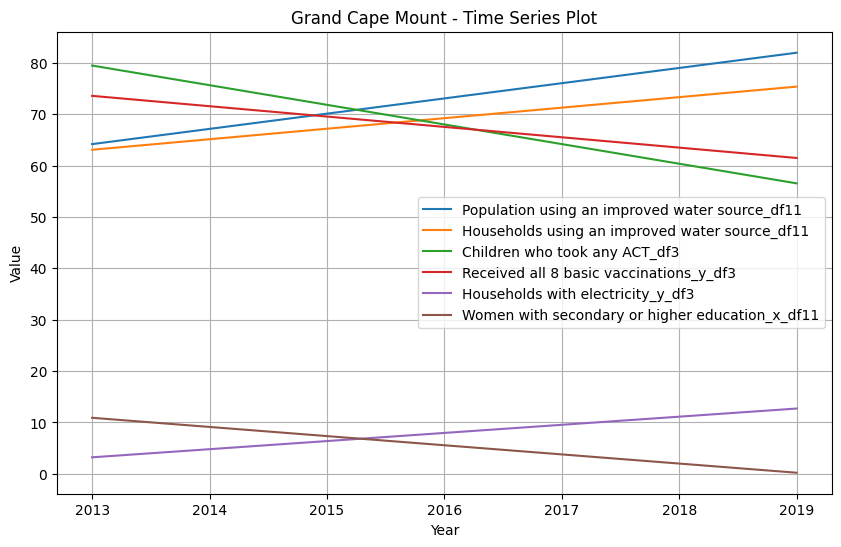

...

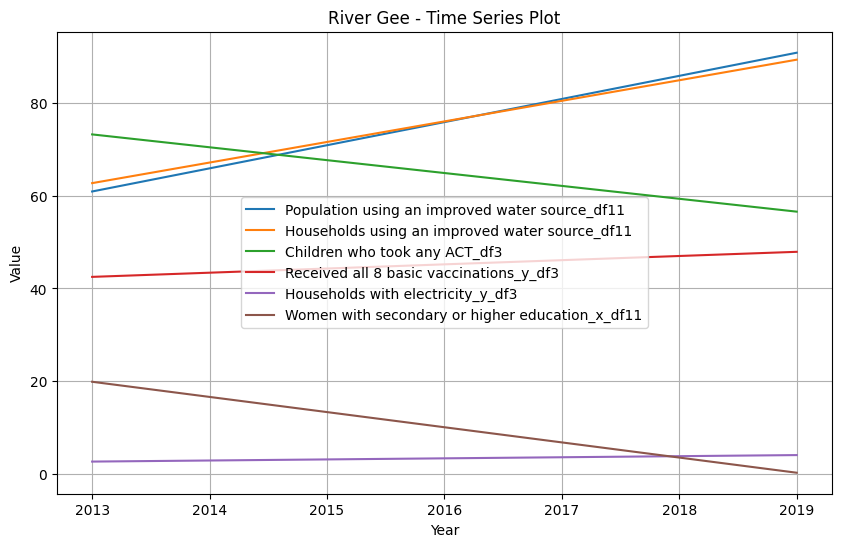

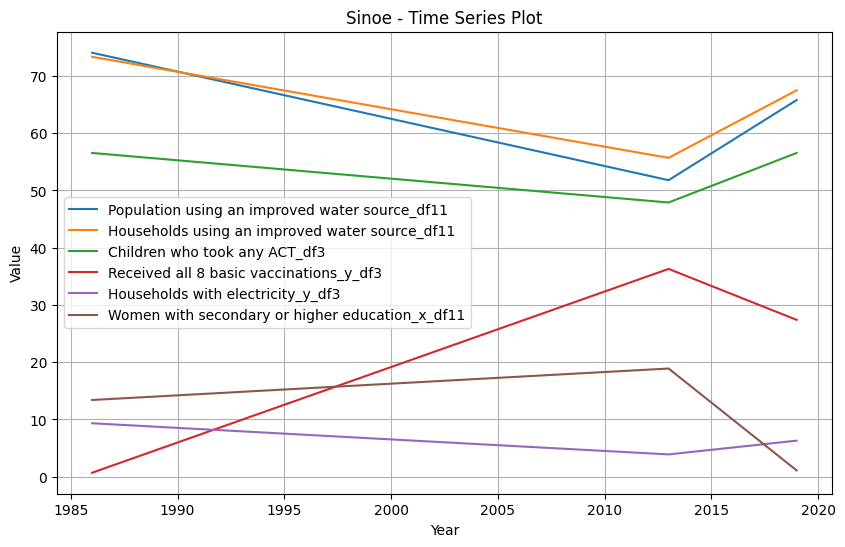

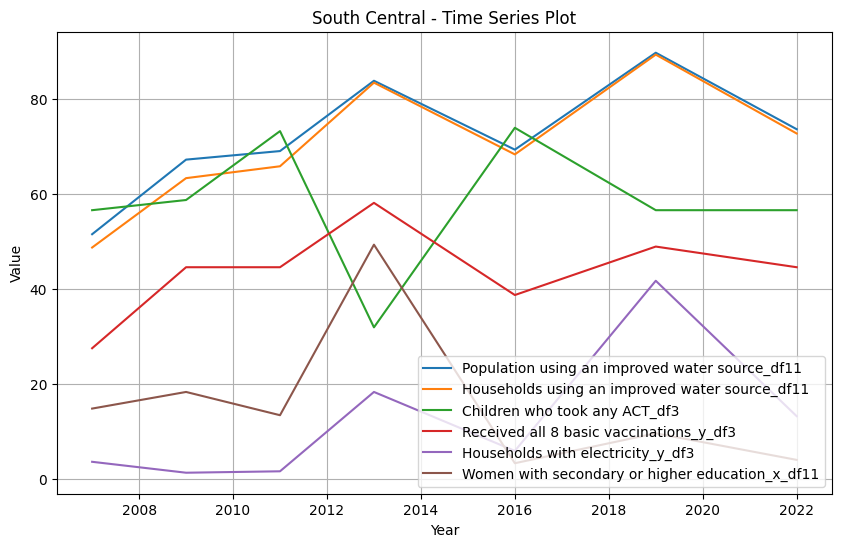

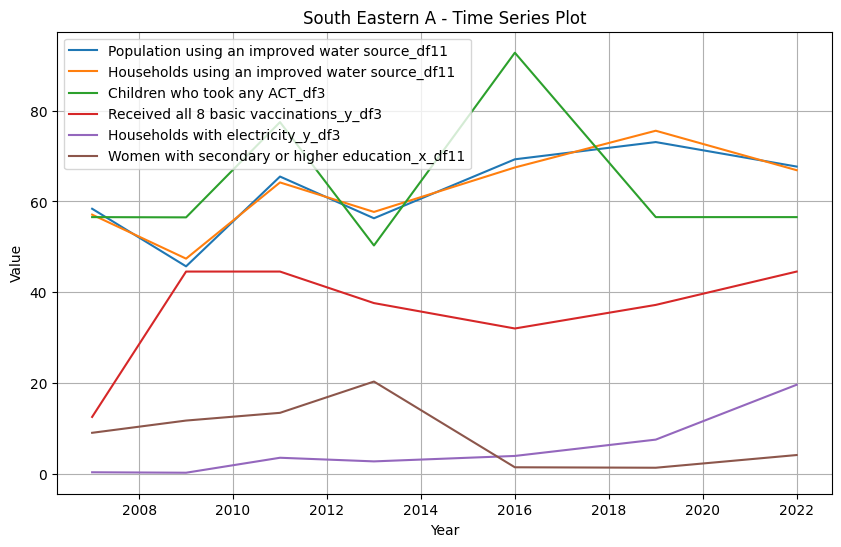

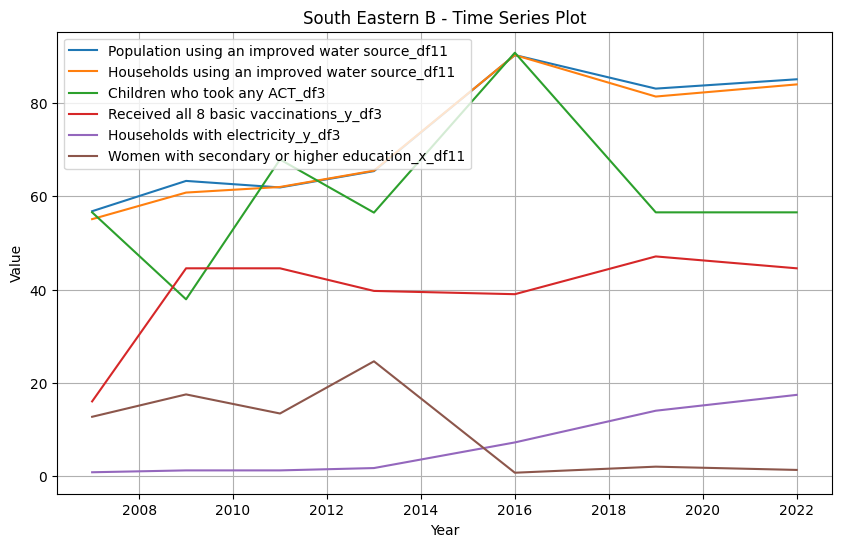

In [ ]:
for country in countries:

  country_data = data_selected[data_selected['Name'] == country]
  years = country_data['Year']
  columns_to_plot = [
'Population using an improved water source_df11',
 'Households using an improved water source_df11',
 'Children who took any ACT_df3', 'Received all 8 basic vaccinations_y_df3',
 'Households with electricity_y_df3',
 'Women with secondary or higher education_x_df11'
 ]

  plt.figure(figsize=(10, 6))
  for column in columns_to_plot:
      plt.plot(years, country_data[column], label=column)

  plt.title(f'{country} - Time Series Plot')
  plt.xlabel('Year')
  plt.ylabel('Value')
  plt.legend()
  plt.grid(True)
  plt.show()